# Clustering and Dimensionality Reduction Exam
Welcome to the weekly project on clustering and dimensionality reduction. You will be working with a dataset of traffic accidents.

## Dataset
The dataset that will be used in this task is `Traffic_Accidents.csv`

## Instructions
- Follow the steps outlined below.
- Write your code in the empty code cells.
- Comment on your code to explain your reasoning.

## Dataset Overview
The dataset contains information about traffic accidents, including location, weather conditions, road conditions, and more. Below are sample of these columns:

* `Location_Easting_OSGR`: Easting coordinate of the accident location.
* `Location_Northing_OSGR`: Northing coordinate of the accident location.
* `Longitude`: Longitude of the accident site.
* `Latitude`: Latitude of the accident site.
* `Police_Force`: Identifier for the police force involved.
* `Accident_Severity`: Severity of the accident.
* `Number_of_Vehicles`: Number of vehicles involved in the accident.
* `Number_of_Casualties`: Number of casualties in the accident.
* `Date`: Date of the accident.
* `Day_of_Week`: Day of the week when the accident occurred.
* `Speed_limit`: Speed limit in the area where the accident occurred.
* `Weather_Conditions`: Weather conditions at the time of the accident.
* `Road_Surface_Conditions`: Condition of the road surface during the accident.
* `Urban_or_Rural_Area`: Whether the accident occurred in an urban or rural area.
* `Year`: Year when the accident was recorded.
* Additional attributes related to road type, pedestrian crossing, light conditions, etc.

## Goal
The primary goal is to analyze the accidents based on their geographical location.


## Import Libraries

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import plotly.graph_objects as go
import plotly.express as px

## Load the Data

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [46]:
df = pd.read_csv('/content/drive/MyDrive/Tuwaiq/Week 3/1-Weekly Task/Datasets/Traffic_Accidents.csv')
df.head()

,Location_Easting_OSGR,Location_Northing_OSGR,Longitude,Latitude,Police_Force,Accident_Severity,Number_of_Vehicles,Number_of_Casualties,Date,Day_of_Week,...,2nd_Road_Class,2nd_Road_Number,Pedestrian_Crossing-Human_Control,Pedestrian_Crossing-Physical_Facilities,Light_Conditions,Weather_Conditions,Road_Surface_Conditions,Urban_or_Rural_Area,Did_Police_Officer_Attend_Scene_of_Accident,Year
0,560530.0,103950.0,0.277298,50.812789,47,3.0,1,1.0,27/11/2009,6,...,-1,0,None within 50 metres,No physical crossing within 50 meters,Darkeness: No street lighting,Raining with high winds,Flood (Over 3cm of water),2.0,Yes,2009
1,508860.0,187170.0,-0.430574,51.572846,1,3.0,2,1.0,10/10/2010,1,...,6,0,None within 50 metres,No physical crossing within 50 meters,Darkness: Street lights present and lit,Fine without high winds,Dry,1.0,Yes,2010
2,314460.0,169130.0,-3.231459,51.414661,62,3.0,2,1.0,14/09/2005,4,...,3,4055,None within 50 metres,No physical crossing within 50 meters,Daylight: Street light present,Fine without high winds,Dry,1.0,Yes,2005
3,341700.0,408330.0,-2.881800,53.568318,4,3.0,1,2.0,18/08/2007,7,...,6,0,None within 50 metres,No physical crossing within 50 meters,Daylight: Street light present,Raining without high winds,Wet/Damp,1.0,Yes,2007
4,386488.0,350090.0,-2.203020,53.047882,21,3.0,2,2.0,06/08/2013,3,...,-1,0,None within 50 metres,No physical crossing within 50 meters,Daylight: Street light present,Fine without high winds,Dry,1.0,Yes,2013


## Exploratory Data Analysis (EDA)
Perform EDA to understand the data better. This involves several steps to summarize the main characteristics, uncover patterns, and establish relationships:
* Find the dataset information and observe the datatypes.
* Check the shape of the data to understand its structure.
* View the the data with various functions to get an initial sense of the data.
* Perform summary statistics on the dataset to grasp central tendencies and variability.
* Check for duplicated data.
* Check for null values.

And apply more if needed!


In [47]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 52000 entries, 0 to 51999
Data columns (total 26 columns):
 #   Column                                       Non-Null Count  Dtype  
---  ------                                       --------------  -----  
 0   Location_Easting_OSGR                        52000 non-null  float64
 1   Location_Northing_OSGR                       52000 non-null  float64
 2   Longitude                                    52000 non-null  float64
 3   Latitude                                     52000 non-null  float64
 4   Police_Force                                 52000 non-null  int64  
 5   Accident_Severity                            51678 non-null  float64
 6   Number_of_Vehicles                           52000 non-null  int64  
 7   Number_of_Casualties                         50959 non-null  float64
 8   Date                                         52000 non-null  object 
 9   Day_of_Week                                  52000 non-null  int64  
 10

In [ ]:
df.describe()

,Location_Easting_OSGR,Location_Northing_OSGR,Longitude,Latitude,Police_Force,Accident_Severity,Number_of_Vehicles,Number_of_Casualties,Day_of_Week,Local_Authority_(District),1st_Road_Class,1st_Road_Number,Speed_limit,2nd_Road_Class,2nd_Road_Number,Urban_or_Rural_Area,Year
count,52000.000000,5.200000e+04,52000.000000,52000.000000,52000.000000,51678.000000,52000.000000,50959.000000,52000.000000,52000.000000,52000.000000,52000.000000,52000.000000,52000.000000,52000.000000,51912.000000,52000.000000
mean,440284.256846,2.998617e+05,-1.427193,52.586684,30.401712,2.837145,1.834327,1.354756,4.130712,349.542558,4.080519,997.078077,39.148558,2.672673,384.503058,1.359397,2009.401788
std,95109.751221,1.613624e+05,1.398249,1.453049,25.545581,0.402582,0.727856,0.855220,1.926217,259.504721,1.428056,1806.405065,14.212826,3.205080,1304.989395,0.479868,3.006997
min,98480.000000,1.903000e+04,-6.895268,50.026153,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,15.000000,-1.000000,-1.000000,1.000000,2005.000000
25%,375540.000000,1.780100e+05,-2.366190,51.487676,7.000000,3.000000,1.000000,1.000000,2.000000,112.000000,3.000000,0.000000,30.000000,-1.000000,0.000000,1.000000,2006.000000
50%,440950.000000,2.671800e+05,-1.391202,52.295042,30.000000,3.000000,2.000000,1.000000,4.000000,323.000000,4.000000,128.500000,30.000000,3.000000,0.000000,1.000000,2010.000000
75%,523500.000000,3.981492e+05,-0.214666,53.478016,46.000000,3.000000,2.000000,1.000000,6.000000,530.000000,6.000000,716.000000,50.000000,6.000000,0.000000,2.000000,2012.000000
max,654960.000000,1.203900e+06,1.753632,60.714774,98.000000,3.000000,34.000000,51.000000,7.000000,941.000000,6.000000,9999.000000,70.000000,6.000000,9999.000000,3.000000,2014.000000


In [48]:
df.shape

(52000, 26)

In [50]:
df.duplicated().sum()

43

In [51]:
df.drop_duplicates(inplace=True)

## Data Preprocessing
Do what you think you need such as:
* Remove the outliers
* Impute missing data
* Scale the data
* Reduce dimentions using PCA
* Implement One-Hot Encoding for nominal categorical variables.

In [52]:
df['Date'] = pd.to_datetime(df['Date'])

<ipython-input-52-b9c6864122be>:1: UserWarning:

Parsing dates in %d/%m/%Y format when dayfirst=False (the default) was specified. Pass `dayfirst=True` or specify a format to silence this warning.



## outliers

In [ ]:
for column in df.columns:
    fig = px.histogram(df, x=column)
    fig.show()


/usr/local/lib/python3.10/dist-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



In [53]:
def remove_outliers(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]

df = remove_outliers(df, 'Location_Northing_OSGR')
df = remove_outliers(df, 'Police_Force')
df = remove_outliers(df, 'Number_of_Vehicles')
df = remove_outliers(df, 'Number_of_Casualties')
df = remove_outliers(df, '1st_Road_Number')
df = remove_outliers(df, '2nd_Road_Number')


In [ ]:
for column in df.columns:
    fig = px.histogram(df, x=column)
    fig.show()

/usr/local/lib/python3.10/dist-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



## Feature selection

In [61]:
df.drop(columns=['Day_of_Week', 'Date', 'Local_Authority_(Highway)', 'Local_Authority_(District)', '1st_Road_Number', '2nd_Road_Number',
                 '2nd_Road_Class', 'Pedestrian_Crossing-Human_Control', 'Year', 'Did_Police_Officer_Attend_Scene_of_Accident' ], axis=1, inplace=True)

## Missing data

In [62]:
df.isnull().sum()

,0
Location_Easting_OSGR,0
Location_Northing_OSGR,0
Longitude,0
Latitude,0
Police_Force,0
Accident_Severity,153
Number_of_Vehicles,0
Number_of_Casualties,0
1st_Road_Class,0
Road_Type,0


In [67]:
from sklearn.impute import SimpleImputer
imputer = SimpleImputer(strategy="most_frequent")
imputer2 = SimpleImputer(strategy="median")

df['Accident_Severity'] = imputer.fit_transform(df[['Accident_Severity']])
df['Urban_or_Rural_Area'] = imputer.fit_transform(df[['Urban_or_Rural_Area']])



df['Light_Conditions'].fillna(df['Light_Conditions'].mode()[0] , inplace=True)

In [68]:
df.isnull().sum()

,0
Location_Easting_OSGR,0
Location_Northing_OSGR,0
Longitude,0
Latitude,0
Police_Force,0
Accident_Severity,0
Number_of_Vehicles,0
Number_of_Casualties,0
1st_Road_Class,0
Road_Type,0


## Data scalling

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 24385 entries, 0 to 51999
Data columns (total 26 columns):
 #   Column                                       Non-Null Count  Dtype         
---  ------                                       --------------  -----         
 0   Location_Easting_OSGR                        24385 non-null  float64       
 1   Location_Northing_OSGR                       24385 non-null  float64       
 2   Longitude                                    24385 non-null  float64       
 3   Latitude                                     24385 non-null  float64       
 4   Police_Force                                 24385 non-null  int64         
 5   Accident_Severity                            24385 non-null  float64       
 6   Number_of_Vehicles                           24385 non-null  int64         
 7   Number_of_Casualties                         24385 non-null  float64       
 8   Date                                         24385 non-null  datetime64[ns]
 9   

In [69]:
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import OrdinalEncoder, OneHotEncoder
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.compose import ColumnTransformer

num_pip = make_pipeline(StandardScaler())
cat_pip_one_hot = make_pipeline(OneHotEncoder(handle_unknown='ignore'))

pre_pip = ColumnTransformer([
    ('scalling_num', num_pip, ['Location_Easting_OSGR', 'Location_Northing_OSGR', 'Longitude', 'Latitude', 'Police_Force',
                               'Number_of_Vehicles', 'Number_of_Casualties','Speed_limit'
                               ]),

    ('cat_one_hot', cat_pip_one_hot, ['Road_Type', 'Light_Conditions','Weather_Conditions', 'Road_Surface_Conditions' ]),
    ])

df_procced = pre_pip.fit_transform(df)


## PCA

In [70]:
from sklearn.decomposition import PCA

# df_procced_dense = df_procced.toarray()

pca = PCA(n_components=8)
pca.fit(df_procced)
pca_tranformed = pca.transform(df_procced)

## Data Visualization
Visualize the data using appropriate plots to gain insights into the dataset. Using the following:
- Scatter plot of accidents based on Longitude and Latitude.

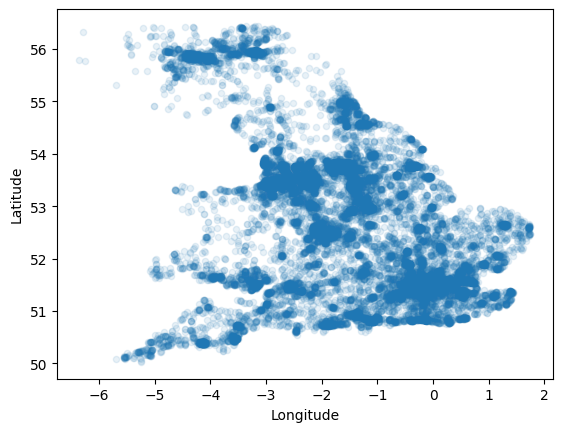

In [71]:
df.plot(kind="scatter", x="Longitude", y="Latitude", alpha=0.1);

## Clustering


In [72]:
from sklearn.cluster import KMeans

# Elbow method
wcss = []
for i in range(1, 10):
    kmeans = KMeans(n_clusters=i , init='k-means++') #initial cluster centroids in a way that tries to make them as far apart from each other as possible
    kmeans.fit(pca_tranformed)
    wcss.append(kmeans.inertia_)#inertia_ attribute of the KMeans object represents the sum of squared distances of samples to their assigned cluster centers


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will 

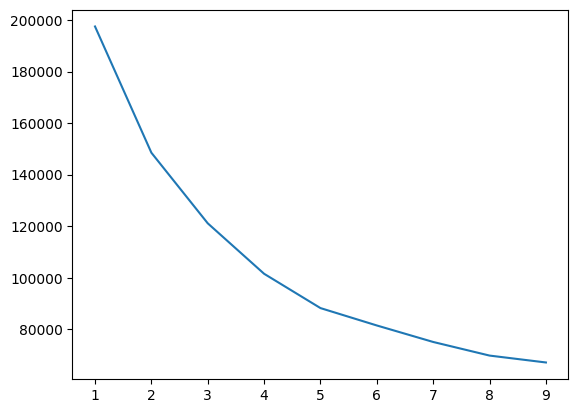

In [73]:
plt.plot(range(1,10),wcss)


**The elbow method showed that k decreases until it becomes 6, after which it remains approximately constant, so I will choose k=6.**

In [74]:
kmeans=KMeans(n_clusters=6,init='k-means++')
kmeans.fit(pca_tranformed)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



KMeans(n_clusters=6)

## Evaluation
Evaluate the clustering result using appropriate metrics.


In [75]:
from sklearn.metrics import silhouette_score

silhouette_avg = silhouette_score(pca_tranformed, kmeans.labels_)
print(f'Silhouette Score: {silhouette_avg}')
#It ranges from -1 to 1, where a score closer to 1 indicates well-defined clusters, a score of 0 indicates overlapping clusters, and a score closer to -1 indicates incorrectly assigned clusters

Silhouette Score: 0.2618021551907844


In [76]:
from sklearn.metrics import calinski_harabasz_score

ch_score = calinski_harabasz_score(pca_tranformed, kmeans.labels_)
print(f'Calinski-Harabasz Index: {ch_score}')
#A higher Calinski-Harabasz Index indicates better-defined clusters, as it suggests that the clusters are compact and well-separated.

Calinski-Harabasz Index: 6938.370549970949


## Plot the data points with their predicted cluster center

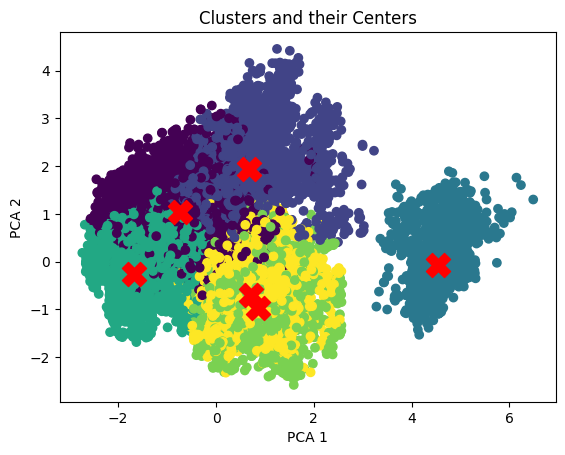

In [77]:
plt.scatter(pca_tranformed[:, 0], pca_tranformed[:, 1], c=kmeans.labels_, cmap='viridis')

plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], s=300, c='red', marker='X')
plt.title('Clusters and their Centers')
plt.xlabel('PCA 1')
plt.ylabel('PCA 2')
plt.show()

## Exam Questions
* **Justify Your Feature Selection:**
   - Which features did you choose for clustering and why?

   - i droped the features that have no correlation in accident
* **Number of Clusters Choices:**
   - How did you determine the optimal number?
   - using elbow mwthod, the gragh showed that the k decreases until it becomes 6, after which it remains approximately constant, so I choosed k=6
* **Evaluation:**
   - Which metrics did you use to evaluate the clustering results, and why?
   - i used Silhouette Score and Calinski-Harabasz Index, those metrics are the best for clustring
   - How do these metrics help in understanding the effectiveness of your clustering approach?
   -Silhouette Score: It ranges from -1 to 1, where a score closer to 1 indicates well-defined clusters, a score of 0 indicates overlapping clusters, and a score closer to -1 indicates incorrectly assigned clusters
   -Calinski-Harabasz Index: A higher Calinski-Harabasz Index indicates better-defined clusters, as it suggests that the clusters are compact and well-separated.
* **Improvements and Recommendations:**
   - Suggest any improvements or future work that could be done with this dataset. What other methods or algorithms would you consider applying?
   some of the columns in data are not clear, an explementation of those column is needed.